In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

# Visualizations will be shown in the notebook.
%matplotlib inline

# Section 1: Camera Calibration

Here we calculate the camera matrix and distortion coefficients using the calibration chessboard images provided in the repository
note these are 9x6 chessboard images
As example, the distortion matrix is used to un-distort one of the calibration images provided as a demonstration that the calibration is correct. 

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

# get camera calibration and distortion correction
#--------------------------------------------------
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[0:2], None, None)

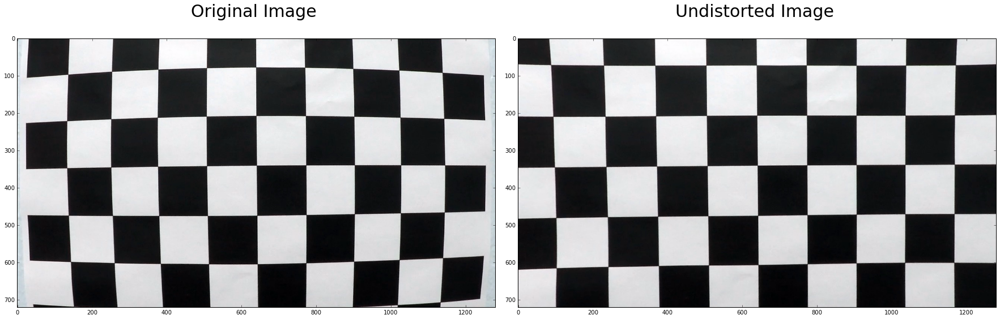

In [3]:
# Apply distortion correction for some Example: 
i = 0 #14, 15
img = cv2.imread(images[i])
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
undist = cv2.undistort(img, mtx, dist, None, mtx)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(img)
ax1.set_title('Original Image \n', fontsize=30)

ax2.imshow(undist)
ax2.set_title('Undistorted Image \n', fontsize=30)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#f.savefig('output_images/undistorted_calibration.png')

# Section 2: Example of Distortion Correction

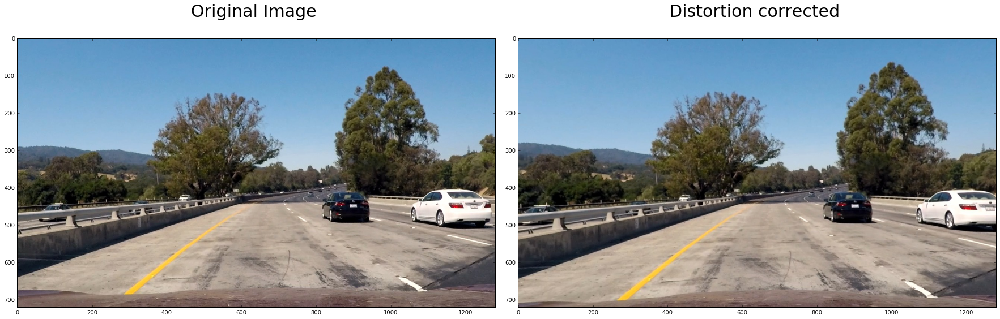

In [4]:
# That's the distortion correction function that will be included in the pipeline.
# here some example:
img = mpimg.imread('test_images/test1.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)

#plot both images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image \n', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Distortion corrected \n', fontsize=30)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#f.savefig('output_images/distortion_corrected.png')

## Section 3: Perspective Transformation

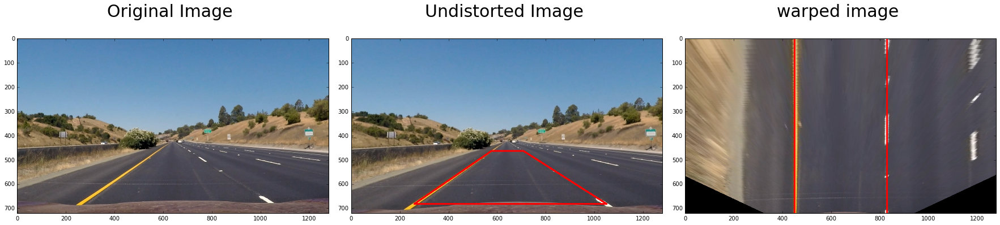

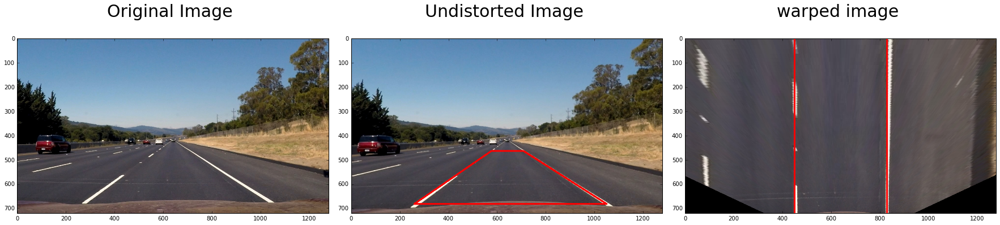

In [3]:
def perspective_transformation(img, src, dst):
    # Compute and apply perpective transform, given a fixed points src, dst
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image
    return(warped,M,Minv)


i=0
# define source and destination points for transform

#src = np.float32([(585,460),
#                  (203,720), 
#                  (1100,720), #(1127,720), 
#                  (698,460)]) #(695,460)
#dst = np.float32([(320,0),
#                  (320,720),
#                  (960,720),
#                  (960,0)])
for filename in ['test_images/straight_lines1.jpg', 'test_images/straight_lines2.jpg']:
    i = i+1
    image = mpimg.imread(filename)
    #undistort the image:
    image_undist = cv2.undistort(image, mtx, dist, None, mtx)
    img_size = (image.shape[1], image.shape[0])

    # define source and destination points for transform
    src = np.float32([(575,464),
                      (258,682),
                      (1049,682),
                      (707,464)])
    dst = np.float32([(450,0),
                      (450,720),
                      (830,720),
                      (830,0)])
 
    warped, M, Minv =  perspective_transformation(image_undist, src, dst)
    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image, cmap='gray')
    ax1.set_title('Original Image \n', fontsize=30)

    cv2.line(image_undist, (src[0][0],src[0][1]), (src[1][0],src[1][1]), [255,0,0], thickness=6)
    cv2.line(image_undist, (src[2][0],src[2][1]), (src[3][0],src[3][1]), [255,0,0], thickness=6)
    cv2.line(image_undist, (src[0][0],src[0][1]), (src[3][0],src[3][1]), [255,0,0], thickness=6)
    cv2.line(image_undist, (src[1][0],src[1][1]), (src[2][0],src[2][1]), [255,0,0], thickness=6)
    ax2.imshow(image_undist, cmap='gray')
    ax2.set_title('Undistorted Image \n', fontsize=30)

    cv2.line(warped, (dst[0][0],dst[0][1]), (dst[1][0],dst[1][1]), [255,0,0], thickness=6)
    cv2.line(warped, (dst[2][0],dst[2][1]), (dst[3][0],dst[3][1]), [255,0,0], thickness=6)    
    ax3.imshow(warped, cmap='gray')      
    ax3.set_title('warped image \n', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    #f.savefig('output_images/persepective_transformation_examples{i}.png'.format(i=i))

## Section 4: Getting binary image with Color transformation and Sobel X operator

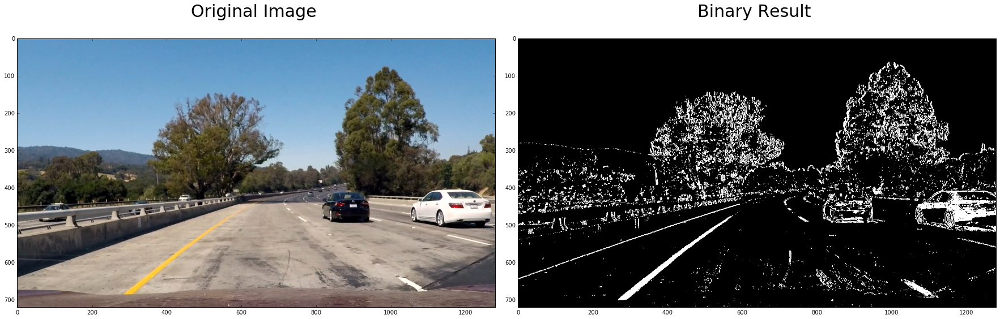

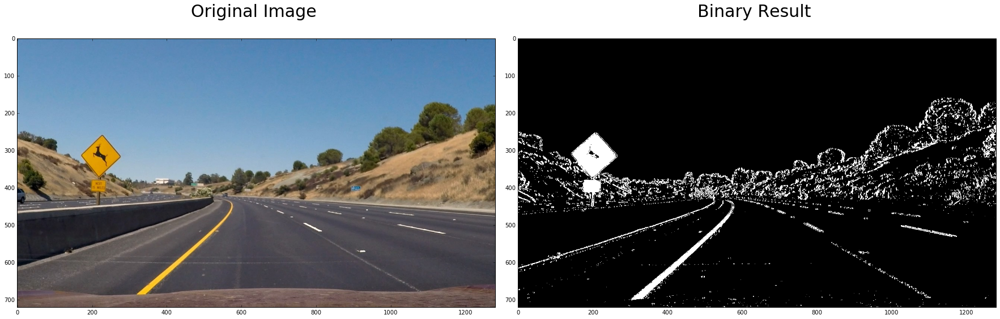

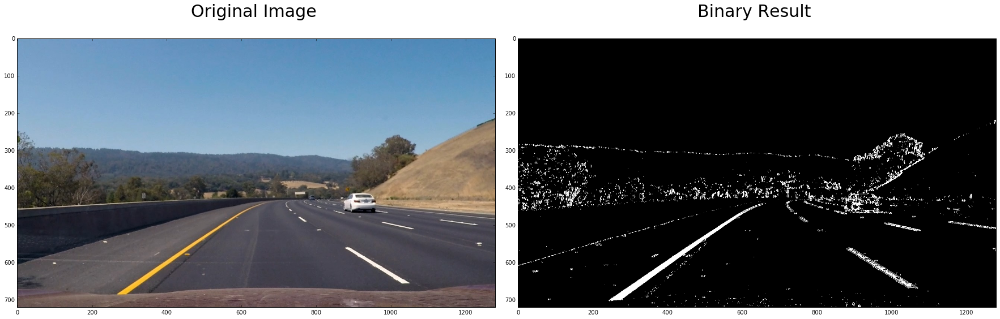

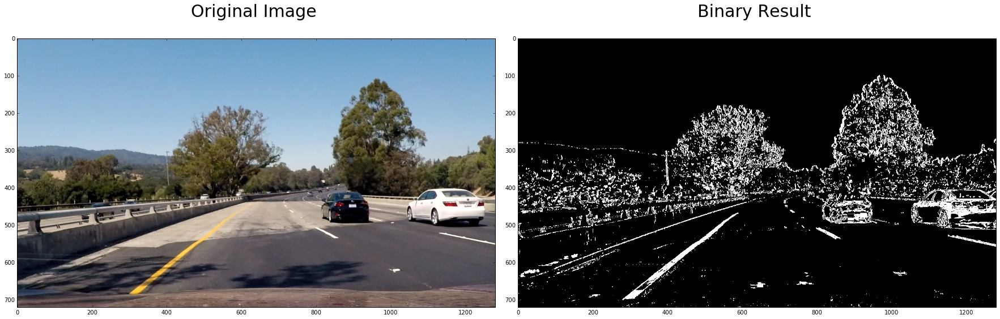

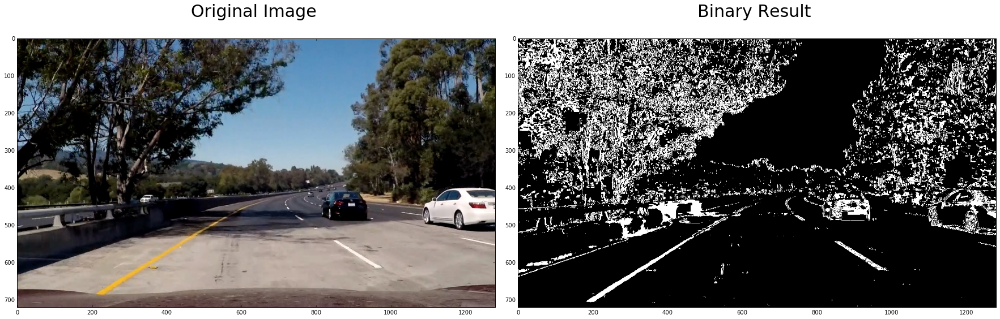

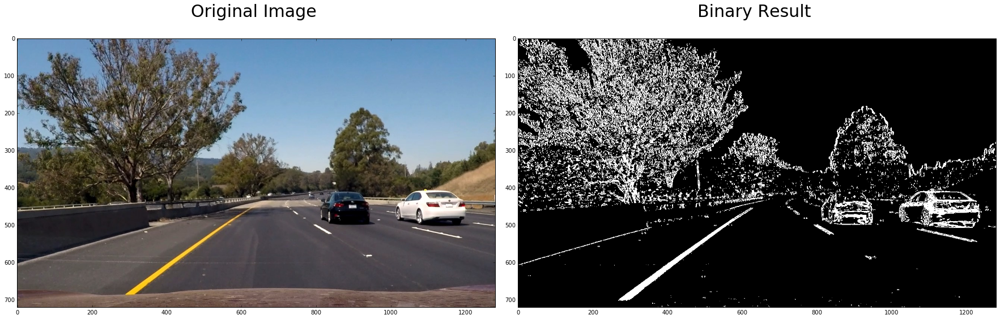

In [4]:
def pipeline_binary_unwarped(img, s_thresh=(170, 255), sx_thresh=(20, 100), sobel_kernel = 3):
    img = np.copy(img)
    
    # Distortion correction
    img = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Get binary image   
    #------------------------
    # Convert to HLS color space:
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel, specially for yellow lines
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    
    # perspective transformation:
    #----------------------------
    #warped, M, Minv =  perspective_transformation(combined_binary, src, dst)
    result = combined_binary
        
    return(result)

# Check test output images from pipeline
i=0
for filename in ['test_images/test1.jpg','test_images/test2.jpg',
                 'test_images/test3.jpg','test_images/test4.jpg',
                'test_images/test5.jpg','test_images/test6.jpg']:
    i = i+1
    image = mpimg.imread(filename)
    result = pipeline_binary_unwarped(image,  s_thresh=(160, 255), sx_thresh=(20, 100),sobel_kernel=3)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image, cmap='gray')
    ax1.set_title('Original Image \n', fontsize=30)
    ax2.imshow(result, cmap='gray')  
    ax2.set_title('Binary Result \n', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

 Here we have another pipeline function, adding finally the perspective transformation:

In [5]:
# complete pipeline with distorsion correction, color and fradient threshold and perspective transformation
def get_l_binnary(warped):
    # Convert to HLS color space -->l channel
    l_thresh=(220, 255)
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    l_channel = l_channel*(255/np.max(l_channel))
       
    # Threshold color channel, specially for yellow lines
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <=l_thresh[1])] = 1
    return(l_binary)

def get_b_binnary(warped):
    b_thresh= (190,255)
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2Lab)
    b_channel = lab[:,:,2]
    if np.max(b_channel) > 175:
        b_channel = b_channel*(255/np.max(b_channel))
    # 2) Apply a threshold to the L channel
    #190,255
    b_binary = np.zeros_like(b_channel)
    b_binary[((b_channel > b_thresh[0]) & (b_channel <= b_thresh[1]))] = 1
    return(b_binary)

def get_sobelx(warped):
    sx_thresh=(20, 100)
    sobel_kernel = 3
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    return(sxbinary)

def pipeline(img):
    img = np.copy(img)
    
    # Distortion correction
    img = cv2.undistort(img, mtx, dist, None, mtx)
    
    # perspective transformation:
    #----------------------------
    warped,M, Minv =  perspective_transformation(img, src, dst)

    # Get binary image   
    #------------------------
    # Convert to HLS color space -->l channel
    l_binary = get_l_binnary(warped)
    

    # Convert to Lab color space --> b channel
    b_binary = get_b_binnary(warped)
                                    
    # Sobel x
    #sxbinary = get_sobelx(warped)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(b_binary)
    combined_binary[(l_binary == 1) | (b_binary == 1) ] = 1  #| (sxbinary == 1) 
    
    result = combined_binary
    return(result,M, Minv)


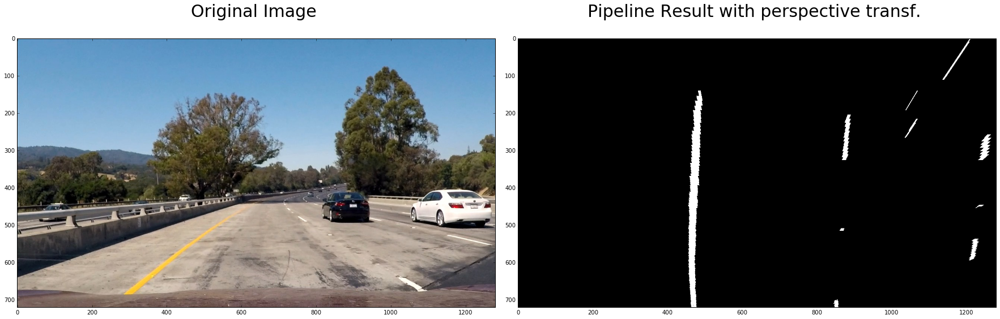

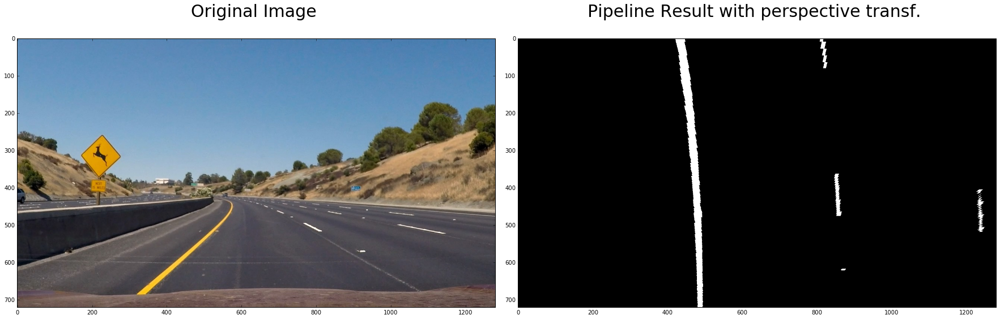

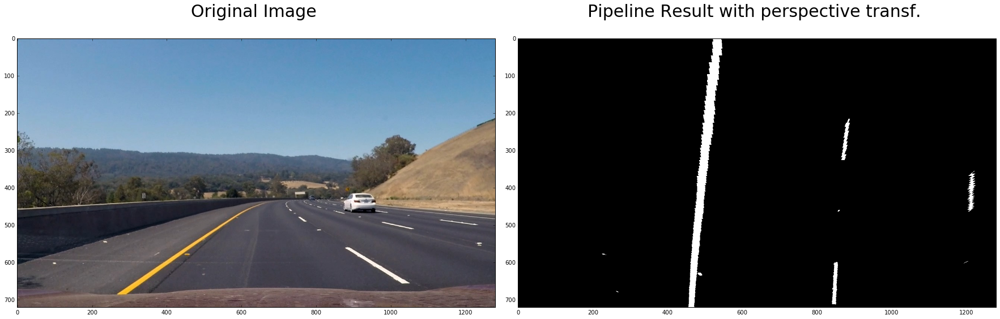

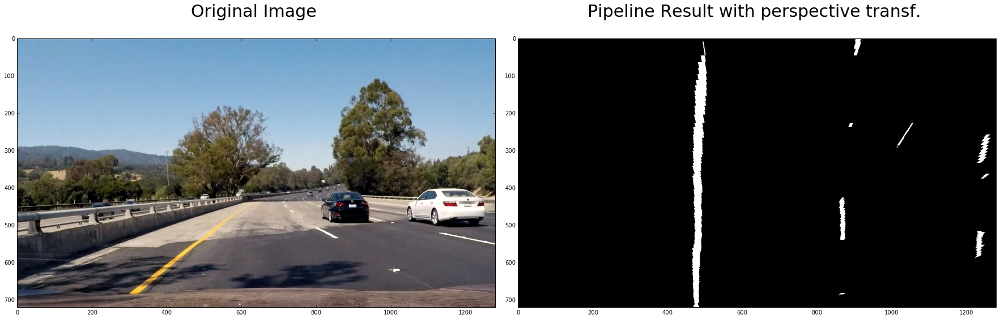

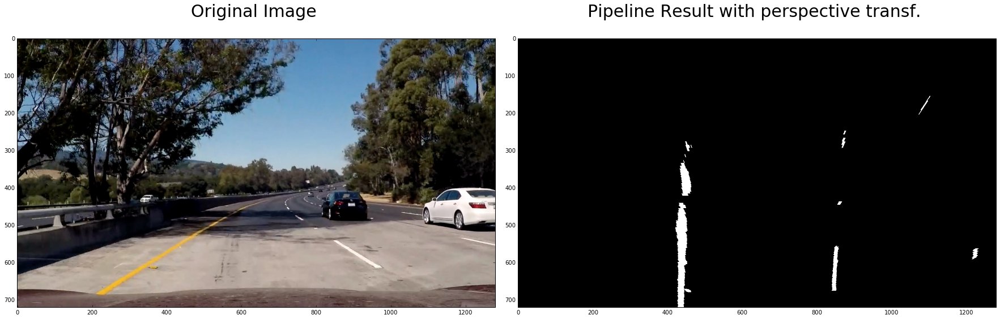

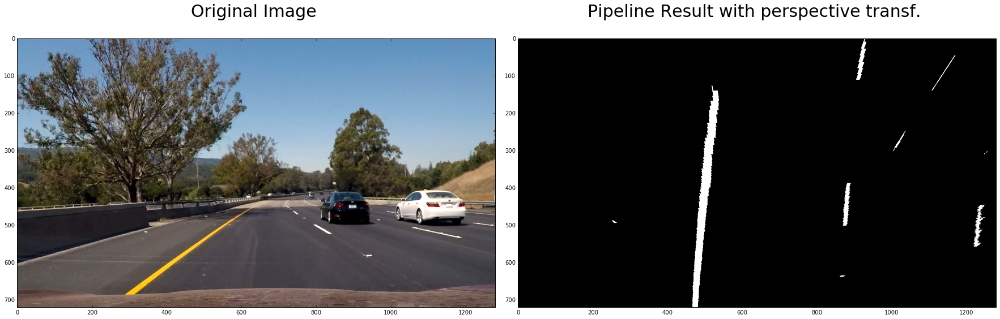

In [38]:
# Check test output images from pipeline
i=0
for filename in ['test_images/test1.jpg','test_images/test2.jpg',
                 'test_images/test3.jpg','test_images/test4.jpg',
                'test_images/test5.jpg','test_images/test6.jpg']:
    i = i+1
    image = mpimg.imread(filename)
    binary_warped,M, Minv = pipeline(image)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image, cmap='gray')
    ax1.set_title('Original Image \n', fontsize=30)
    ax2.imshow(binary_warped, cmap='gray')  
    ax2.set_title('Pipeline Result with perspective transf. \n', fontsize=30)
    #ax2.set_title('Binary Result \n', fontsize=30)
        
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    #f.savefig('output_images/binary_example_with_perspective_transf{i}.png'.format(i=i))

## Section 5: Line Finding Methods

In [6]:
def find_lines(binary_warped):
#    plt.figure()
#    plt.imshow(binary_warped, cmap='gray')
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    out_img = np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    #border = np.int(histogram.shape[0]*7/100)
    border = 100
    right_border = np.int(histogram.shape[0])-border
    leftx_base = np.argmax(histogram[border:midpoint]) + border
    rightx_base = np.argmax(histogram[midpoint:right_border]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        #print(window, window_height, (win_xleft_low,win_y_low),(win_xleft_high,win_y_high))
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        #plt.figure()
        #plt.imshow(out_img, cmap='gray')
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
#    plt.figure()
#    plt.imshow(out_img, cmap='gray')
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    #print(len(leftx),len(lefty),len(rightx),len(righty))
    if (len(leftx)>0) & (len(lefty)>0) &( len(rightx)>0) & (len(righty)>0):
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        print('No line found...')
        return(out_img,[],[],0,0,0)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    y_eval = np.max(ploty)
    left_curverad,right_curverad = get_curvature(leftx, lefty,rightx, righty,y_eval)
    offset = get_offset(left_fit,right_fit,y_eval,w=binary_warped.shape[1])
    
    return(out_img, left_fit, right_fit,left_curverad, right_curverad, offset)

def get_curvature(leftx, lefty,rightx, righty,y_eval):
    # Calculate curvature of the road
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    
    # in pixels....
    #left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    #right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    #print(left_curverad, right_curverad)
    # in meters...
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radious of curvature (in m.)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    return(left_curverad,right_curverad)

def get_offset(left_fit,right_fit,y_eval,w):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Calculating lane center offset from vehicle camera:
    bottom_left = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
    bottom_right = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
    lane_center = (bottom_right-bottom_left) / 2 + bottom_left
    car_center = w/2.
    offset = lane_center - car_center
    #print(bottom_left, bottom_right, lane_center,car_center, offset)
    offset = offset * xm_per_pix
    return(offset)


def find_lines_from_prev_frame(binary_warped, left_fit_prev, right_fit_prev):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit_prev[0]*(nonzeroy**2) + left_fit_prev[1]*nonzeroy + left_fit_prev[2] - margin)) & (nonzerox < (left_fit_prev[0]*(nonzeroy**2) + left_fit_prev[1]*nonzeroy + left_fit_prev[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit_prev[0]*(nonzeroy**2) + right_fit_prev[1]*nonzeroy + right_fit_prev[2] - margin)) & (nonzerox < (right_fit_prev[0]*(nonzeroy**2) + right_fit_prev[1]*nonzeroy + right_fit_prev[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    #Get params:
    y_eval = np.max(ploty)
    left_curverad,right_curverad = get_curvature(leftx, lefty,rightx, righty,y_eval)
    offset = get_offset(left_fit,right_fit,y_eval,w=binary_warped.shape[1])
    
    return(out_img, left_fit, right_fit,left_curverad, right_curverad, offset)


def print_onto_road(image, binary_warped, left_fit, right_fit, Minv):
    new_img = np.copy(image)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))


    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,0), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,0,255), thickness=15)


    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, newwarp, 0.3, 0)
    #plt.imshow(result)
    return(result)

def print_text_on_image(image, avg_curve, offset):
    new_img = np.copy(image)
    height = new_img.shape[0]
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Radius of curvature: ' + '{:04.2f}'.format(avg_curve) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1., (200,255,155), 2, cv2.LINE_AA)
    if offset > 0:
        direction = 'left'
    elif offset <= 0:
        direction = 'right'
    text = '{:04.3f}'.format(abs(offset)) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1., (200,255,155), 2, cv2.LINE_AA)
    return(new_img)


1712.80996451 m 8776.54822915 m offset:  0.10128614237 m
1582.94793315 m 3825.74329662 m offset:  0.213065881095 m
4485.21260869 m 1758.62888178 m offset:  0.0736532850047 m
3289.33934363 m 1437.65950873 m offset:  0.17110262276 m
1249.70183856 m 8400.96665179 m offset:  -0.00242686211419 m
2964.98849474 m 1964.10840046 m offset:  0.151822609308 m


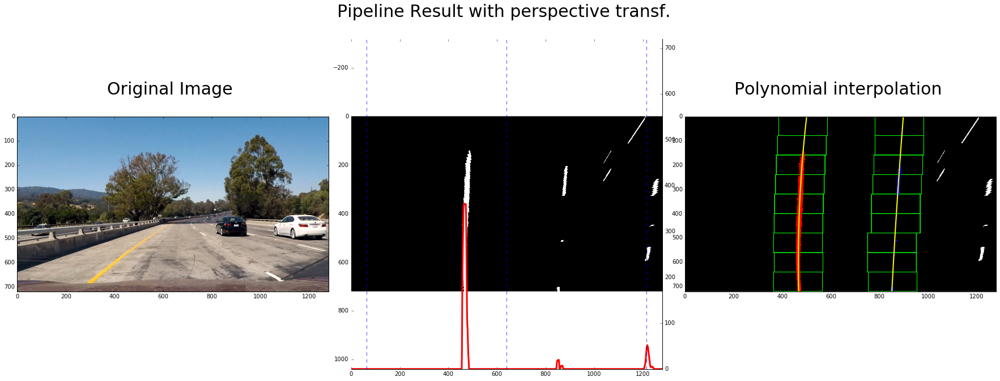

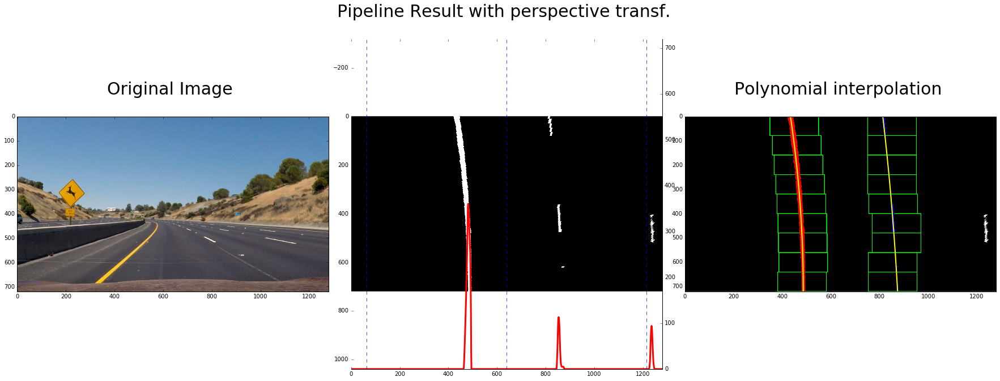

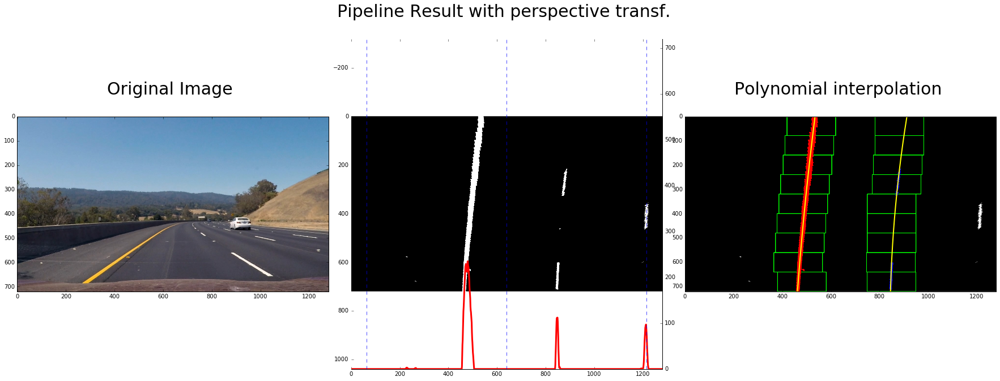

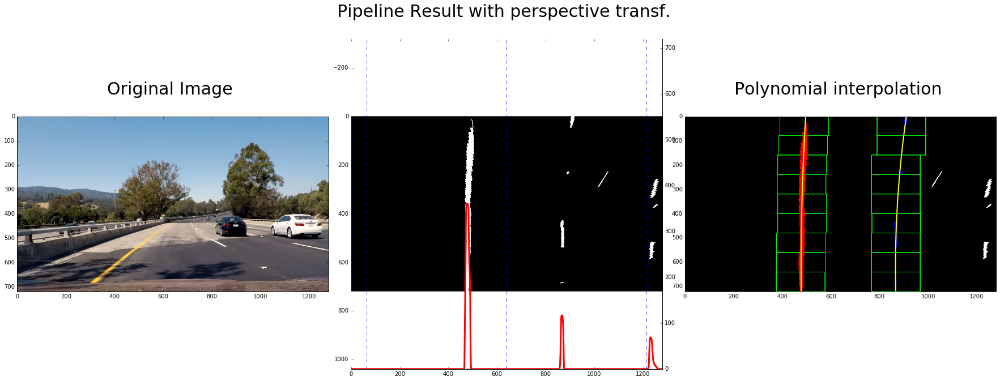

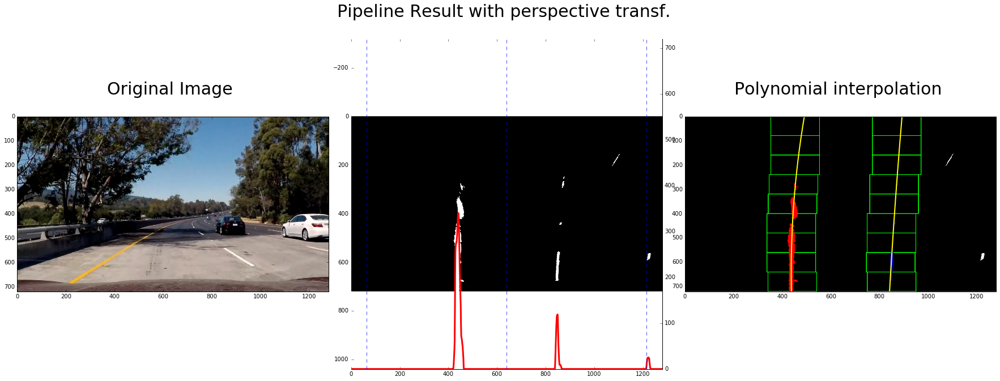

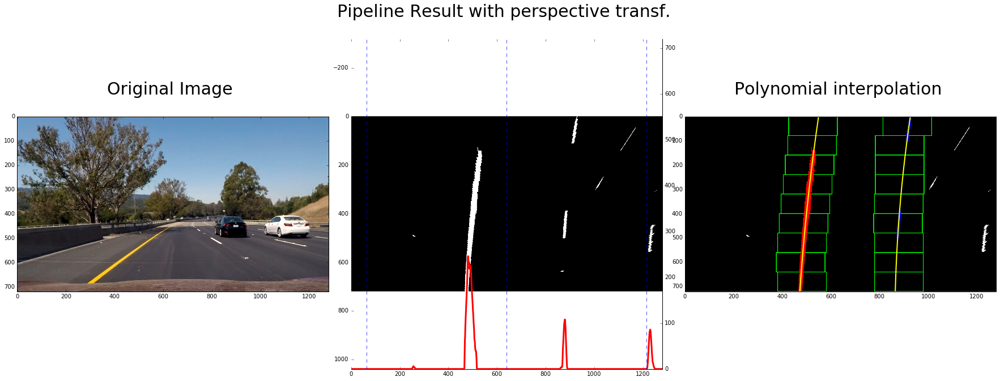

In [70]:

# Check test output images from pipeline, and line findeing
i=0
for filename in ['test_images/test1.jpg','test_images/test2.jpg',
                 'test_images/test3.jpg','test_images/test4.jpg',
                 'test_images/test5.jpg','test_images/test6.jpg']:
    i = i+1
    image = mpimg.imread(filename)
    binary_warped, M, Minv = pipeline(image)
    
    # Find lines
    out_img, left_fit, right_fit,left_curverad, right_curverad , offset= find_lines(binary_warped)
    
    
    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm', 'offset: ', offset , 'm')

    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    h = binary_warped.shape[0]
    bottom_left =  left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
    bottom_right = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
    top_left =  left_fit[0]*0**2 + left_fit[1]*0 + left_fit[2]
    top_right = right_fit[0]*0**2 + right_fit[1]*0 + right_fit[2]
    #print('bottom: ',bottom_left, bottom_right, bottom_right-bottom_left)
    #print('top: ',top_left, top_right, top_right-top_left)
    
# Plot the result
    #-------------------
    f, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    # First plot, normal image 
    ax1.imshow(image, cmap='gray')
    ax1.set_title('Original Image \n', fontsize=30)
    
    # Second plot, binary_warped + lane lines histogram
    ax2.imshow(binary_warped, cmap='gray')  
    ax2.set_title('Pipeline Result with perspective transf. \n', fontsize=30)
    ax2.spines['left'].set_visible(False)
    ax2.spines['top'].set_visible(False)
    #ax2.set_title('Binary Result \n', fontsize=30)
    ax22 = ax2.twinx()
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    ax22.plot(histogram, color='red', linewidth=3)
    midpoint = np.int(histogram.shape[0]/2)
    border = np.int(histogram.shape[0]*5/100)
    ax22.axvline(midpoint,color = 'blue', alpha = 0.7,linestyle='--')
    ax22.axvline(border,color = 'blue', alpha = 0.7,linestyle='--')
    ax22.axvline(histogram.shape[0] - border, color = 'blue', alpha = 0.7,linestyle='--')
    ax22.set_xlim(0, 1280)
    ax22.set_ylim(0,720)
    ax22.spines['left'].set_visible(False)
    ax22.spines['top'].set_visible(False)

    # Third plot, Add calculated plynomial lines images
    ax3.imshow(out_img, cmap='gray')
    ax3.plot(left_fitx, ploty, color='yellow', linewidth=2)
    ax3.plot(right_fitx, ploty, color='yellow', linewidth=2)
    ax3.set_xlim(0, 1280)
    ax3.set_ylim(720, 0)
    ax3.set_title('Polynomial interpolation \n', fontsize=30)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    f.savefig('output_images/Polynomial_interpolations{i}.png'.format(i=i))
    


C:\Users\anna.busquet\AppData\Local\Continuum\Anaconda\envs\py34\lib\site-packages\ipykernel\__main__.py:4: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


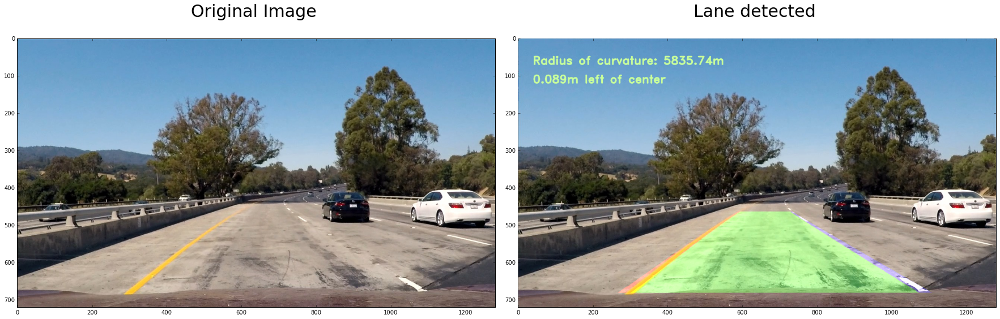

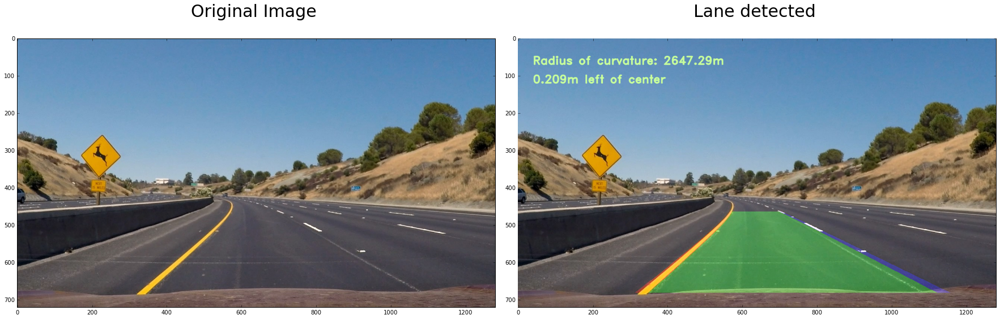

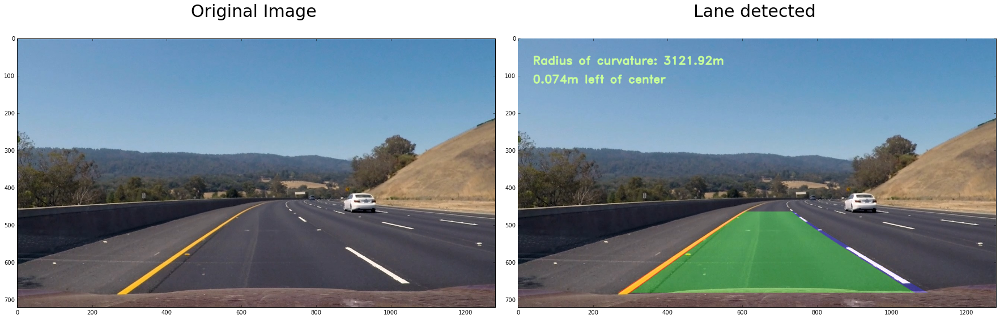

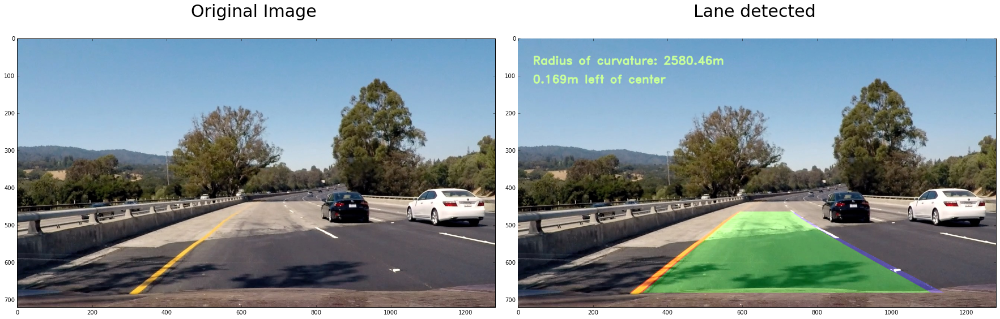

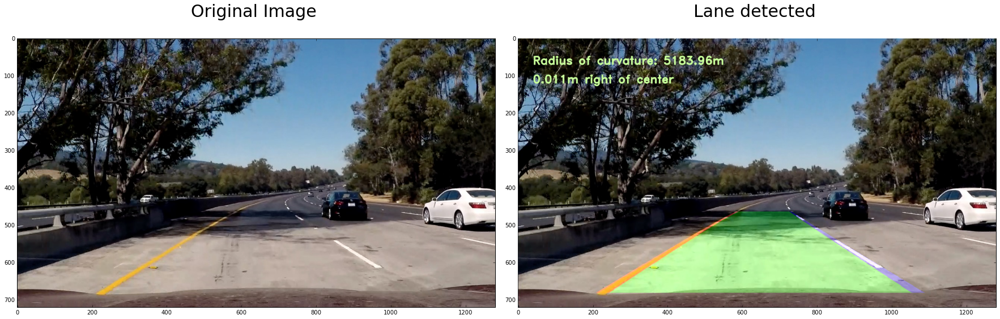

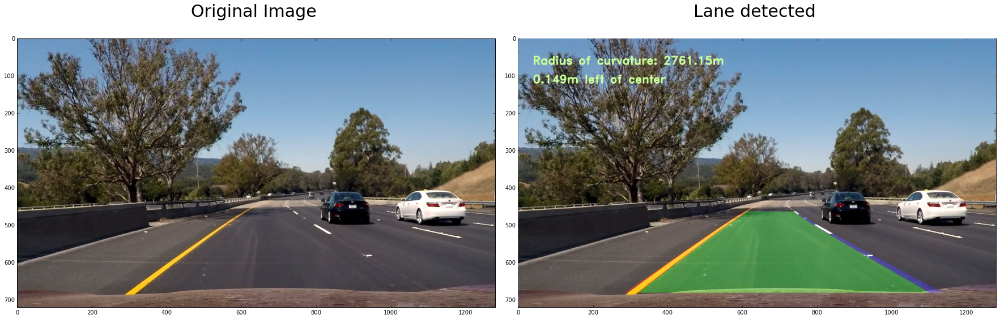

In [15]:
i= 0
for filename in ['test_images/test1.jpg','test_images/test2.jpg',
                 'test_images/test3.jpg','test_images/test4.jpg',
                'test_images/test5.jpg','test_images/test6.jpg']:
    i = i+1
    image = mpimg.imread(filename)
    binary_warped, M, Minv = pipeline(image)
    # Find lines
    out_img, left_fit, right_fit, left_curverad, right_curverad , offset= find_lines(binary_warped)
    # Project again onto the raod image:
    image_lines_road = print_onto_road(image, binary_warped, left_fit, right_fit, Minv)
    # Now our radius of curvature is in meters
    #print(left_curverad, 'm', right_curverad, 'm', 'offset: ', offset , 'm')
    avg_curve = (left_curverad + right_curverad) / 2
    image_lines_road = print_text_on_image(image_lines_road, avg_curve, offset)

    
    # Plot the result
    #-------------------
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # First plot, normal image 
    ax1.imshow(image, cmap='gray')
    ax1.set_title('Original Image \n', fontsize=30)
    
    # Second plot, binary_warped + lane lines histogram
    ax2.imshow(image_lines_road, cmap='gray')  
    ax2.set_title('Lane detected \n', fontsize=30)
    ax2.spines['left'].set_visible(False)
    ax2.spines['top'].set_visible(False)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    #f.savefig('output_images/Lane_detected{i}.png'.format(i=i))

## Section 6: All together, the complete pipeline with all steps

In [12]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = []#None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        # store bottom and top values for polynomial intercept
        self.bottom = []
        self.top = []
    
def detected_lines_sanity_check(left_fit, right_fit, left_curverad, right_curverad, offset, h, l_line, r_line):
    
    if (len(right_fit)==0) | (len(left_fit)==0):
        print('Empty fit')
        return(False)
    
    # Chech if lines are more or less parallel:            
    bottom_left =  left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
    bottom_right = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
    top_left =  left_fit[0]*0**2 + left_fit[1]*0 + left_fit[2]
    top_right = right_fit[0]*0**2 + right_fit[1]*0 + right_fit[2]
    
    if top_right - top_left <= 0. :
        print('Crossing lines detected !')
        return(False)
    # check parallel lines:
    if abs(abs(top_right-top_left )- abs(bottom_left - bottom_right))>=150:
        print('Not parallel lines detected! ')
        return(False)
    # check for pronounced courves:
    if abs(left_curverad) < 500 or abs(right_curverad) < 500:
        print('Too low radio of curvature...')
        return(False)
    
    l_line.bottom.append(bottom_left)
    r_line.bottom.append(bottom_right)
    l_line.top.append(top_left)
    r_line.top.append(top_right)
    l_line.radius_of_curvature.append(left_curverad)
    r_line.radius_of_curvature.append(right_curverad)
    
    #print('bottom: ',bottom_left, bottom_right, bottom_right-bottom_left)
    #print('top: ',top_left, top_right, top_right-top_left)
    return(True)      


# Full pipeline, returning images with detected lane area:
#----------------------------------------------------------
def pilpeline_draw_lane_lines(img,l_line, r_line):

    img = np.copy(img)
    
    # Distortion correction
    #------------------------
    img = cv2.undistort(img, mtx, dist, None, mtx)
    
    # perspective transformation:
    #----------------------------
    warped,M, Minv =  perspective_transformation(img, src, dst)

    # Get binary image   
    #------------------------
    # Convert to HLS color space -->l channel
    l_binary = get_l_binnary(warped)
    

    # Convert to Lab color space --> b channel
    b_binary = get_b_binnary(warped)
                                        
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(b_binary)
    combined_binary[(l_binary == 1) | (b_binary == 1) ] = 1  #| (sxbinary == 1) 
    
    binary_warped = combined_binary
    
    # Line finding :
    #----------------
    out_img, left_fit, right_fit, left_curverad, right_curverad , offset= find_lines(binary_warped)
    
    # Perform Sanity check on the calculated lines:
    #----------------------------------------------
    h = binary_warped.shape[0]
    status = detected_lines_sanity_check(left_fit, right_fit, left_curverad, right_curverad, offset, h, l_line, r_line)
    
    if (status == False) & (l_line.detected == True) & (r_line.detected == True):
        # Detected lines are not good enough. we have to use previous detected lines:
        print('using previous lines detected....')
        out_img, left_fit, right_fit, left_curverad, right_curverad , offset = find_lines_from_prev_frame(binary_warped, l_line.current_fit , r_line.current_fit )
        #l_line.detected = False
        #r_line.detected = False
        
    # Updating l_line and r_line instances:
    l_line.detected = True
    r_line.detected = True
    l_line.current_fit = left_fit
    r_line.current_fit = right_fit        
        
    # Print text
    #------------
    image_lines_road = print_onto_road(img, binary_warped, left_fit, right_fit, Minv)
    avg_curve = (left_curverad + right_curverad) / 2
    image_lines_road = print_text_on_image(image_lines_road, avg_curve, offset)


    ## Add aditional text:
    #font = cv2.FONT_HERSHEY_DUPLEX
    #text = '{:04.3f}'.format(right_curverad- left_curverad) + ', ' +'{:04.3f}'.format((right_curverad- left_curverad)/left_curverad) + ', ' + '{:04.3f}'.format(left_curverad) + ', ' + '{:04.3f}'.format(right_curverad)
    #cv2.putText(image_lines_road, text, (40,170), font, 1., (200,255,155), 2, cv2.LINE_AA)

    #text = str(left_fit) 
    #cv2.putText(image_lines_road, text, (40,220), font, 1., (200,255,155), 2, cv2.LINE_AA)
    
    #text = str(right_fit)
    #cv2.putText(image_lines_road, text, (40,270), font, 1., (200,255,155), 2, cv2.LINE_AA)


    result = image_lines_road    
    
    return(image_lines_road)



In [8]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

  warn(skimage_deprecation('The `skimage.filter` module has been renamed '



In [9]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image with lines are drawn on lanes)
    
    result = pilpeline_draw_lane_lines(image, l_line, r_line)
    return(result)

In [13]:
l_line = Line()
r_line = Line()
output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


  0%|                                                           | 0/1261 [00:00<?, ?it/s]WARNING:py.warnings:C:\Users\anna.busquet\AppData\Local\Continuum\Anaconda\envs\py34\lib\site-packages\ipykernel\__main__.py:6: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future

100%|███████████████████████████████████████████████▉| 1260/1261 [06:20<00:00,  4.23it/s]

Too low radio of curvature...
using previous lines detected....
[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 6min 23s


In [14]:
from scipy import stats
print(stats.describe(l_line.bottom))
print(stats.describe(r_line.bottom))
print(stats.describe(l_line.top))
print(stats.describe(r_line.top))
#print(stats.describe(l_line.radius_of_curvature))
#print(stats.describe(r_line.radius_of_curvature))
r_line.current_fit
#n, bins, patches = plt.hist(l_line.radius_of_curvature, 20, align='left',   alpha=0.75)
#l_line.radius_of_curvature

DescribeResult(nobs=1260, minmax=(425.81072495208554, 502.59058302180244), mean=469.88440091634811, variance=207.61763770160243, skewness=-0.03259870660092511, kurtosis=-0.1784648534948925)
DescribeResult(nobs=1260, minmax=(823.18315213738902, 884.99452830443113), mean=853.91825784801608, variance=111.50601983890324, skewness=0.3812778000513254, kurtosis=0.13012361721126808)
DescribeResult(nobs=1260, minmax=(393.82165190508397, 580.34946343345587), mean=484.77800978222496, variance=2495.0068024026896, skewness=-0.04764666702297774, kurtosis=-1.184179642010845)
DescribeResult(nobs=1260, minmax=(739.85743252930649, 961.8760943687945), mean=868.3688778051785, variance=3399.3372144404671, skewness=-0.4472505739669388, kurtosis=-1.1345811463036586)


array([  1.50477548e-05,  -2.23118183e-02,   8.87893329e+02])

In [82]:
#diff_rel = [(b-a)/a for (a,b) in zip(l_line.radius_of_curvature,r_line.radius_of_curvature)]
#diff = [(b-a) for (a,b) in zip(l_line.radius_of_curvature,r_line.radius_of_curvature)]

In [15]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))